# Credit Risk Analysis for LendingClub

## About LendingClub

LendingClub is a financial technology company that operates a peer-to-peer (P2P) lending platform. Founded in 2006, it initially allowed individuals to lend money directly to other individuals seeking personal loans, bypassing traditional financial institutions. Over time, LendingClub expanded its offerings and services.

Here’s a brief overview of what they do:

* Personal Loans: LendingClub connects borrowers with investors willing to fund their personal loans. Borrowers can use these loans for various purposes like consolidating debt, making large purchases, or covering unexpected expenses
  
* Business Loans: They also offer loans to small businesses. These loans help businesses with capital needs such as expansion, equipment purchases, or working capital

* Auto Refinancing: LendingClub provides refinancing options for auto loans, allowing borrowers to potentially lower their interest rates and reduce monthly payments

* Medical Financing: They offer loans specifically for medical expenses, helping patients manage costs for procedures or treatments

* Investor Opportunities: On the flip side, investors can invest in fractional shares of loans, allowing them to diversify their investments and potentially earn returns based on the interest payments from the borrowers

LendingClub uses technology and data to assess the creditworthiness of borrowers and match them with suitable investors. Their platform aims to offer competitive rates and more accessible borrowing options compared to traditional banks and lenders

Lending Club Website: https://www.lendingclub.com/

##### **Business Context**

In this case study we’ll be analyzing past loan applicants of a company which is the largest online loan marketplace, facilitating personal loans, business loans, and financing of medical procedures for approving loan applications. Borrowers, can easily access lower interest rate loans through a fast online interface exposed by the company. Therefore, we can assume that large number of transactions takes place in the company w.r.t the loans applications.

**Business Problem Statement**

Like most other lending companies, lending loans to ‘risky’ applicants is the largest source of financial loss (called credit loss) to a bank/lender therefore we need to perform analysis w.r.t below mentioned points and provide action plans & recommendations to minimize the risk of the potential defaulters from the provided past loans comma seperated file as much as possible:

- How many risky loan applicants? 
- Driving factors (or driver variables) behind loan default i.e. the variables which are strong indicators of default?
- Assess any changes in borrowers' creditworthiness
- The five Cs of credit - capacity, capital, conditions, and character

## Exploratory Data Analysis (EDA)

#### **EDA Objective:**

Given the set of attributes and the corresponding data our aim is to use EDA to 
1. Understand how **consumer attributes** and **loan attributes** influence the tendency of default 
2. Understand the **driving factors (or driver variables) behind loan default**, i.e. the variables which are strong indicators of default.

#### **EDA Approach**

Few steps to clean & Transform data:

1. Data cleaning and transformation

 - Fixing rows & columns
   - Delete summary rows: Total, Subtotal rows
   - Delete incorrect rows: Header rows, Footer rows
   - Delete extra rows: Column number, indicators, Blank rows, Page No.
   - Merge columns for creating unique identifiers
   - Split columns for more data
   - Add column names: Add column names if missing
   - Rename columns consistently: Abbreviations, encoded columns
   - Delete columns: Delete unnecessary columns
   - Align misaligned columns: Dataset may have shifted columns
     
 - Removing missing values
   - Set values as missing values: Identify values that indicate missing data
   - Delete rows, columns
   - Fill partial missing values
     
 - Standardising values
   - Standardise units
   - Scale values if required
   - Standardise precision
   - Remove outliers
     
 - Invalid values
   - Convert incorrect data types
   - Correct values that go beyond
   - Correct values not in the list
   - Validate internal rules
     
 - Filter data
   - Deduplicate data
   - Filter rows: Filter by segment, filter by date period to get only the rows relevant to the analysis
   - Filter columns: Pick columns relevant to the analysis
   - Aggregate data: Group by required keys, aggregate the rest
  
2. Segmented Analysis
 - Segmented Univariate On
    - Numerical Variables 
    - Categorical Variables
    - Date Based Variables
 - Segmented Bivariate On
    - Numerical Variables 
    - Categorical Variables


Note :- Since the aim of EDA is to find the important driver variables behind default loans, we need to do comparative study of relationship between target variable with other variables. Thus for our EDA goal univariate, segmented univariate and bivariate analysis is more useful and we can do limited univariate analysis since univariate analysis help us understand the data pattern for the individual variable only.

In [13]:
#import the libraries
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as mplt
import plotly.express as px
import plotly.graph_objects as go

# Mathematical calculation
import numpy as np


# Ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [14]:
#Read the dataset and check the first five rows
loan_df = pd.read_csv("loan.csv")
loan_df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


In [15]:
# Check the shape of the dataframe
loan_df.shape

(39717, 111)

##### **There are no extra rows & columns in the dataset to delete which consists of Header/Footer**

In [17]:
# Check the datatypes of all the columns of the dataframe
loan_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Columns: 111 entries, id to total_il_high_credit_limit
dtypes: float64(74), int64(13), object(24)
memory usage: 33.6+ MB


In [18]:
# Check the datatypes of all the columns of the dataframe
loan_df.dtypes

id                              int64
member_id                       int64
loan_amnt                       int64
funded_amnt                     int64
funded_amnt_inv               float64
                               ...   
tax_liens                     float64
tot_hi_cred_lim               float64
total_bal_ex_mort             float64
total_bc_limit                float64
total_il_high_credit_limit    float64
Length: 111, dtype: object

In [19]:
# No duplicate rows
loan_df[loan_df.duplicated(['id'])]
loan_df.isnull().all(axis=1).sum()

0

In [20]:
# Check the columns of the dataframe for the total number of nulls
loan_df.isnull().sum()

id                                0
member_id                         0
loan_amnt                         0
funded_amnt                       0
funded_amnt_inv                   0
                              ...  
tax_liens                        39
tot_hi_cred_lim               39717
total_bal_ex_mort             39717
total_bc_limit                39717
total_il_high_credit_limit    39717
Length: 111, dtype: int64

In [21]:
# Drop the columns where all the values or maximum more than 85% are null, as they can't contribute and we can't predict the loan status with null values
df_with_dropped_null_columns = loan_df.drop(columns=['tot_hi_cred_lim', 'total_bal_ex_mort', 'total_bc_limit', 'total_il_high_credit_limit', 'percent_bc_gt_75', 'num_tl_90g_dpd_24m', 'num_tl_op_past_12m',
                                          'pct_tl_nvr_dlq', 'num_tl_90g_dpd_24m', 'num_tl_op_past_12m', 'pct_tl_nvr_dlq', 'num_sats', 'num_tl_120dpd_2m', 'num_tl_30dpd', 'num_op_rev_tl',
                                          'num_rev_accts', 'num_rev_tl_bal_gt_0', 'num_bc_sats', 'num_bc_tl', 'num_il_tl', 'num_accts_ever_120_pd','num_actv_bc_tl','num_actv_rev_tl',
                                          'mths_since_recent_bc_dlq','mths_since_recent_inq', 'mths_since_recent_revol_delinq','mo_sin_rcnt_tl','mort_acc','mths_since_recent_bc',
                                          'mo_sin_old_il_acct','mo_sin_old_rev_tl_op','mo_sin_rcnt_rev_tl_op', 'bc_util', 'bc_open_to_buy', 'avg_cur_bal', 'acc_open_past_24mths',
                                          'inq_last_12m', 'total_cu_tl', 'inq_fi', 'total_rev_hi_lim', 'all_util', 'max_bal_bc', 'open_rv_24m', 'open_rv_12m', 'il_util', 'total_bal_il',
                                          'mths_since_rcnt_il', 'open_il_24m', 'open_il_12m', 'open_il_6m', 'open_acc_6m', 'tot_cur_bal', 'tot_coll_amt', 'mths_since_last_major_derog',
                                           'annual_inc_joint', 'dti_joint', 'verification_status_joint', 'mths_since_last_record', 'mths_since_last_record', 'next_pymnt_d',
                                          'mths_since_last_delinq'])


In [22]:
# Verify the total number of columns & nulls
df_with_dropped_null_columns.isnull().sum()

id                                0
member_id                         0
loan_amnt                         0
funded_amnt                       0
funded_amnt_inv                   0
term                              0
int_rate                          0
installment                       0
grade                             0
sub_grade                         0
emp_title                      2459
emp_length                     1075
home_ownership                    0
annual_inc                        0
verification_status               0
issue_d                           0
loan_status                       0
pymnt_plan                        0
url                               0
desc                          12940
purpose                           0
title                            11
zip_code                          0
addr_state                        0
dti                               0
delinq_2yrs                       0
earliest_cr_line                  0
inq_last_6mths              

## Based on the columns information following Analysis will be performed on the dataset  
- Univariate analysis
- Segemented univariate analysis
- Bivariate analysis - We will conclude it from the univarite or segemented univariate analysis
- Perform Correlation -  On the numerical data/facts and drive the conclusions
- Columns of no use therefore we will delete following columns - initial_list_status, recoveries, collection_recovery_fee, policy_code - All values are same f, application_type - All values are same INDIVIDUAL, acc_now_delinq - All values are same 0, chargeoff_within_12_mths - All values are same 0
- Columns of no use therefore we will delete following columns - delinq_amnt - All values are same 0, tax_liens - All values are same 0

In [24]:
# Drop the above mentioned columns 
df_with_dropped_null_columns = df_with_dropped_null_columns.drop(columns=['initial_list_status', 'recoveries', 'collection_recovery_fee', 'policy_code', 'application_type', 'acc_now_delinq', 'chargeoff_within_12_mths',
                                          'delinq_amnt', 'tax_liens', 'collections_12_mths_ex_med', 'desc', 'url'])

In [25]:
# Again check the datatypes of all the columns of the dataframe
df_with_dropped_null_columns.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 42 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   id                    39717 non-null  int64  
 1   member_id             39717 non-null  int64  
 2   loan_amnt             39717 non-null  int64  
 3   funded_amnt           39717 non-null  int64  
 4   funded_amnt_inv       39717 non-null  float64
 5   term                  39717 non-null  object 
 6   int_rate              39717 non-null  object 
 7   installment           39717 non-null  float64
 8   grade                 39717 non-null  object 
 9   sub_grade             39717 non-null  object 
 10  emp_title             37258 non-null  object 
 11  emp_length            38642 non-null  object 
 12  home_ownership        39717 non-null  object 
 13  annual_inc            39717 non-null  float64
 14  verification_status   39717 non-null  object 
 15  issue_d            

In [26]:
# Calculate the percentage w.r.t the null data in the columns
# Below percentage looks fine therefore no further deletions
round((df_with_dropped_null_columns.isnull().sum()/df_with_dropped_null_columns.shape[0]*100), 2)

id                      0.00
member_id               0.00
loan_amnt               0.00
funded_amnt             0.00
funded_amnt_inv         0.00
term                    0.00
int_rate                0.00
installment             0.00
grade                   0.00
sub_grade               0.00
emp_title               6.19
emp_length              2.71
home_ownership          0.00
annual_inc              0.00
verification_status     0.00
issue_d                 0.00
loan_status             0.00
pymnt_plan              0.00
purpose                 0.00
title                   0.03
zip_code                0.00
addr_state              0.00
dti                     0.00
delinq_2yrs             0.00
earliest_cr_line        0.00
inq_last_6mths          0.00
open_acc                0.00
pub_rec                 0.00
revol_bal               0.00
revol_util              0.13
total_acc               0.00
out_prncp               0.00
out_prncp_inv           0.00
total_pymnt             0.00
total_pymnt_in

In [27]:
# Massaging data for the columns which are not correct to perform the analysis such as removing %, + characters from the numerical fields

from datetime import datetime

def getDate(x):
    y = x.split('-')
    if y[0].isnumeric():
        return datetime.strptime(y[1] + '-' + y[0], "%b-%y")
    else:
        return datetime.strptime(x, "%b-%y") 

df_with_dropped_null_columns['int_rate'] = df_with_dropped_null_columns['int_rate'].apply(lambda x: float(str(x).replace('%', '')))
df_with_dropped_null_columns['revol_util'] = df_with_dropped_null_columns['revol_util'].apply(lambda x: float(str(x).replace('%', '')))
df_with_dropped_null_columns['issue_d'] = df_with_dropped_null_columns['issue_d'].apply(getDate)

df_with_dropped_null_columns['issue_mth'] = pd.DatetimeIndex(df_with_dropped_null_columns['issue_d']).month
df_with_dropped_null_columns['issue_yr'] = pd.DatetimeIndex(df_with_dropped_null_columns['issue_d']).year
#df_with_dropped_null_columns['term'] = df_with_dropped_null_columns['term'].apply(lambda x: int(x.replace(' months','')))


In [28]:
# Drop the rows with Current loan status, as they are of no use for predicting the defaulters
df_with_fully_paid_and_charged_off_loan_status = df_with_dropped_null_columns[~(df_with_dropped_null_columns['loan_status'] == "Current")]

df_with_fully_paid_loan_status = df_with_dropped_null_columns[(df_with_dropped_null_columns['loan_status'] == "Fully Paid")]
df_with_fully_paid_loan_status

df_with_charged_off_loan_status = df_with_dropped_null_columns[(df_with_dropped_null_columns['loan_status'] == "Charged Off")]
df_with_charged_off_loan_status

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,pub_rec_bankruptcies,issue_mth,issue_yr
1,1077430,1314167,2500,2500,2500.0,60 months,15.27,59.83,C,C4,...,1008.71,456.46,435.17,0.00,Apr-13,119.66,Sep-13,0.0,12,2011
8,1071795,1306957,5600,5600,5600.0,60 months,21.28,152.39,F,F2,...,646.02,162.02,294.94,0.00,Apr-12,152.39,Aug-12,0.0,12,2011
9,1071570,1306721,5375,5375,5350.0,60 months,12.69,121.45,B,B5,...,1469.34,673.48,533.42,0.00,Nov-12,121.45,Mar-13,0.0,12,2011
12,1064687,1298717,9000,9000,9000.0,36 months,13.49,305.38,C,C1,...,2270.70,1256.14,570.26,0.00,Jul-12,305.38,Nov-12,0.0,12,2011
14,1069057,1303503,10000,10000,10000.0,36 months,10.65,325.74,B,B2,...,7471.99,5433.47,1393.42,0.00,Oct-13,325.74,Mar-14,0.0,12,2011
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39667,118823,118026,2500,2500,675.0,36 months,12.80,84.00,D,D4,...,599.28,1706.01,477.21,1.69,Mar-10,1.76,May-16,NaN,8,2007
39668,118533,117783,2500,2500,825.0,36 months,9.64,80.26,B,B4,...,688.35,1730.83,354.44,1.36,Mar-10,1.40,May-16,NaN,8,2007
39669,118523,118519,6500,6500,225.0,36 months,15.01,225.37,F,F1,...,139.42,2886.21,1168.14,0.00,Feb-09,225.37,May-16,NaN,8,2007
39678,113179,113093,1000,1000,950.0,36 months,10.59,32.55,C,C2,...,668.87,544.02,138.64,0.00,May-09,32.55,Oct-09,NaN,8,2007


In [29]:
# Again check the datatypes of all the columns of the dataframe
df_with_fully_paid_and_charged_off_loan_status.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38577 entries, 0 to 39716
Data columns (total 44 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   id                    38577 non-null  int64         
 1   member_id             38577 non-null  int64         
 2   loan_amnt             38577 non-null  int64         
 3   funded_amnt           38577 non-null  int64         
 4   funded_amnt_inv       38577 non-null  float64       
 5   term                  38577 non-null  object        
 6   int_rate              38577 non-null  float64       
 7   installment           38577 non-null  float64       
 8   grade                 38577 non-null  object        
 9   sub_grade             38577 non-null  object        
 10  emp_title             36191 non-null  object        
 11  emp_length            37544 non-null  object        
 12  home_ownership        38577 non-null  object        
 13  annual_inc      

## Remove Outliers

##### Loan Amount - Max is 35 & upper fence is 29.55 we should be fine with the outliers

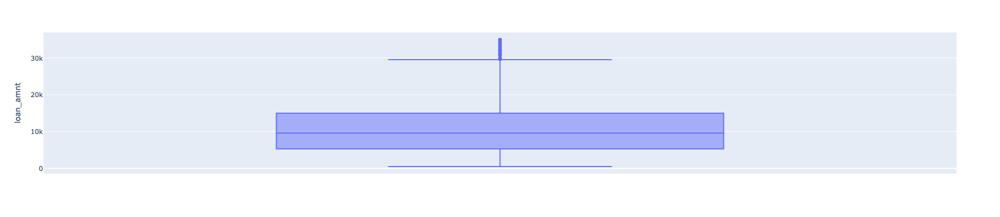

In [32]:
px.box(df_with_fully_paid_and_charged_off_loan_status, y = df_with_fully_paid_and_charged_off_loan_status['loan_amnt'], width=500, height=400).show()

##### Interest Rate - Max is 24.4 & upper fence is 22.48 we should be fine with the outliers

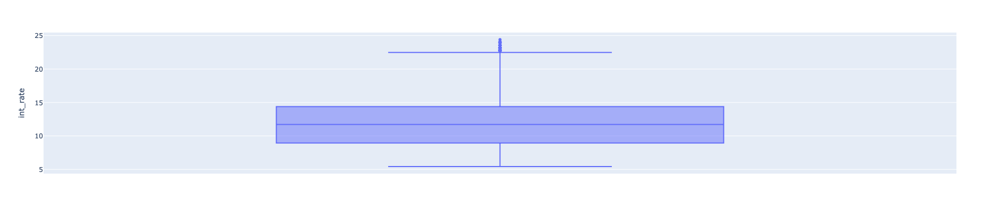

In [34]:
px.box(df_with_fully_paid_and_charged_off_loan_status, y = df_with_fully_paid_and_charged_off_loan_status['int_rate'], width=500, height=400).show()

##### DTI - Max & upper fence are same therefore no issue

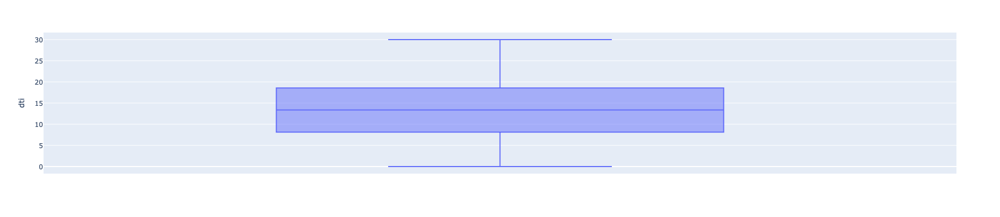

In [36]:
px.box(df_with_fully_paid_and_charged_off_loan_status, y = df_with_fully_paid_and_charged_off_loan_status['dti'], width=500, height=400).show()

##### Funded Amount - Max is 35 & upper fence is 30 we should be fine with the outliers, almost same as loan amount

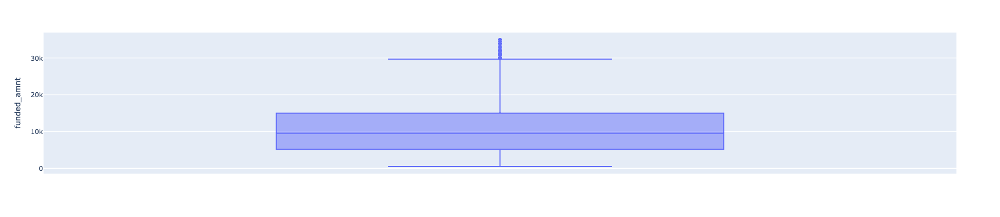

(38577, 44)

In [38]:
px.box(df_with_fully_paid_and_charged_off_loan_status, y = df_with_fully_paid_and_charged_off_loan_status['funded_amnt'], width=500, height=400).show()
df_with_fully_paid_and_charged_off_loan_status.shape

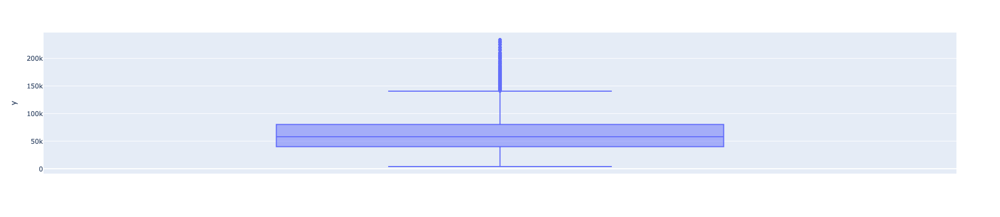

None


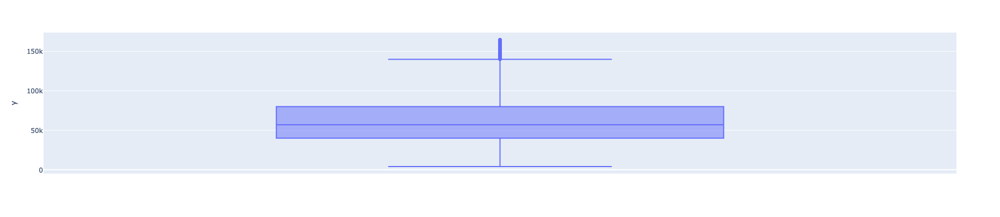

None


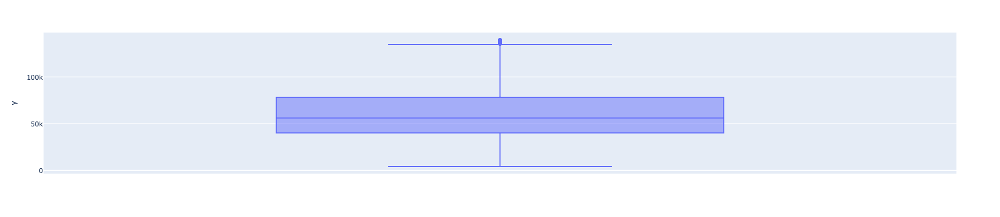

None


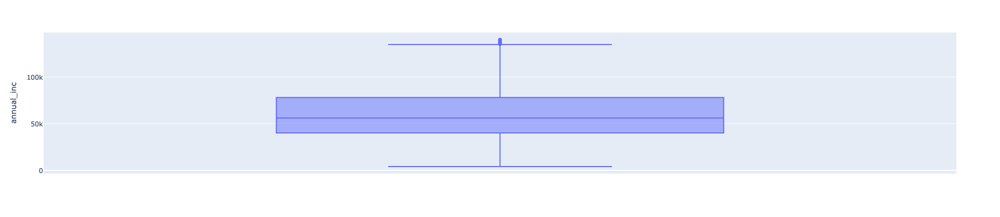

In [39]:
# There are lot of outliers for annual income lets reduce the data with different percentiles and verify 

percentile_numbers = [99, 97, 95]

for percentile in percentile_numbers:
    data_value = np.percentile(df_with_fully_paid_and_charged_off_loan_status[['annual_inc']], percentile)
    df2 = df_with_fully_paid_and_charged_off_loan_status[df_with_fully_paid_and_charged_off_loan_status['annual_inc'].apply(lambda x: x <= data_value)]
    print(px.box(df_with_fully_paid_and_charged_off_loan_status, y = df2['annual_inc'], width=500, height=400).show())

# 1. There is huge difference between upper fence 140k and max 234k. Therefore, we can exclude it
# 2. Not much difference between upper fence 140k and max 165k. However, lets check with 95
# 3. 95 percentile looks good, we will go with it

df_with_fully_paid_and_charged_off_loan_status = df2
# Print plot to verify we have correct data
px.box(df_with_fully_paid_and_charged_off_loan_status, y = df_with_fully_paid_and_charged_off_loan_status['annual_inc'], width=500, height=400).show()

##### No outliers in DTIs

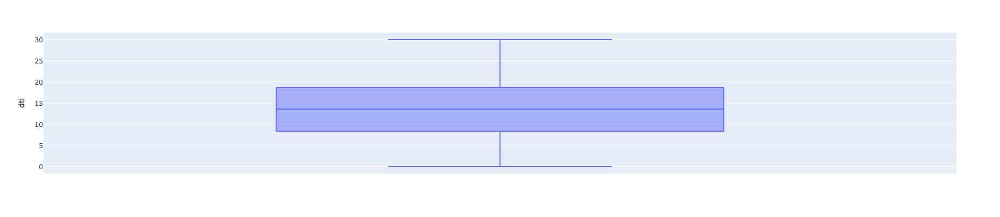

In [41]:
px.box(df_with_fully_paid_and_charged_off_loan_status, y = df_with_fully_paid_and_charged_off_loan_status['dti'], width=500, height=400).show()

In [42]:
# Verifying the dataframe
df_with_fully_paid_and_charged_off_loan_status

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,pub_rec_bankruptcies,issue_mth,issue_yr
0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,...,5833.84,5000.00,863.16,0.00,Jan-15,171.62,May-16,0.0,12,2011
1,1077430,1314167,2500,2500,2500.0,60 months,15.27,59.83,C,C4,...,1008.71,456.46,435.17,0.00,Apr-13,119.66,Sep-13,0.0,12,2011
2,1077175,1313524,2400,2400,2400.0,36 months,15.96,84.33,C,C5,...,3005.67,2400.00,605.67,0.00,Jun-14,649.91,May-16,0.0,12,2011
3,1076863,1277178,10000,10000,10000.0,36 months,13.49,339.31,C,C1,...,12231.89,10000.00,2214.92,16.97,Jan-15,357.48,Apr-16,0.0,12,2011
5,1075269,1311441,5000,5000,5000.0,36 months,7.90,156.46,A,A4,...,5632.21,5000.00,632.21,0.00,Jan-15,161.03,Jan-16,0.0,12,2011
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39711,92402,92390,5000,5000,700.0,36 months,8.70,158.30,B,B1,...,797.80,5000.00,698.60,0.00,Jul-10,159.83,Nov-14,NaN,7,2007
39712,92187,92174,2500,2500,1075.0,36 months,8.07,78.42,A,A4,...,1213.88,2500.00,322.97,0.00,Jul-10,80.90,Jun-10,NaN,7,2007
39713,90665,90607,8500,8500,875.0,36 months,10.28,275.38,C,C1,...,1020.51,8500.00,1413.49,0.00,Jul-10,281.94,Jul-10,NaN,7,2007
39714,90395,90390,5000,5000,1325.0,36 months,8.07,156.84,A,A4,...,1397.12,5000.00,272.16,0.00,Apr-08,0.00,Jun-07,NaN,7,2007


### Understanding Target Variable

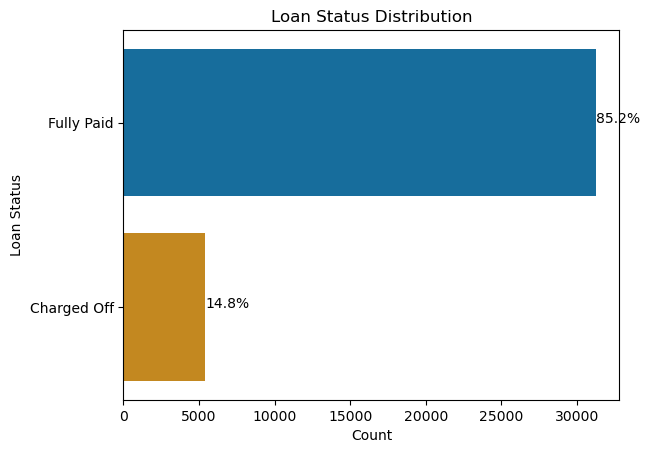

In [44]:
# Plot Target Variable Distribution
# Create the countplot and naming it 'plot'. 
plot = sns.countplot(y='loan_status', data=df_with_fully_paid_and_charged_off_loan_status, palette='colorblind')

mplt.xlabel('Count')
mplt.ylabel('Loan Status')
mplt.title('Loan Status Distribution')

total = len(df_with_fully_paid_and_charged_off_loan_status['loan_status']) 

for p in plot.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width() / total)
    x = p.get_x() + p.get_width() + 0.02
    y = p.get_y() + p.get_height() / 2
    plot.annotate(percentage, (x, y))
mplt.show()

# Univariate Analysis

#### UA Analysis 1: Most of the loans are applied by the customers within the 10+ years range

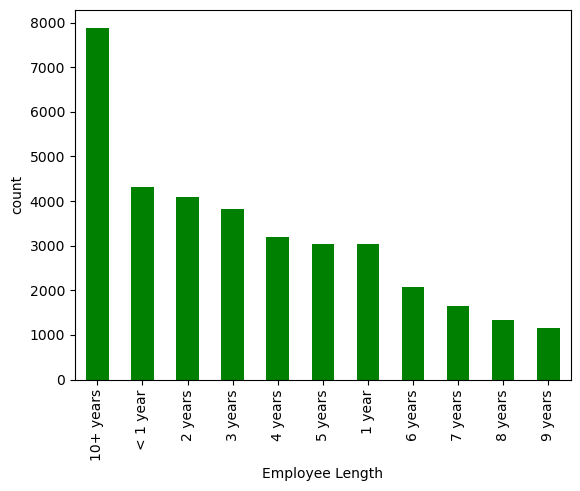

In [47]:
ax = df_with_fully_paid_and_charged_off_loan_status['emp_length'].value_counts().plot.bar(color=['green'])
ax.set_xlabel('Employee Length')
ax.set_ylabel('count')
mplt.show()

#### UA Analysis 2: Most of the loan amount is within 5000 - 10000 range

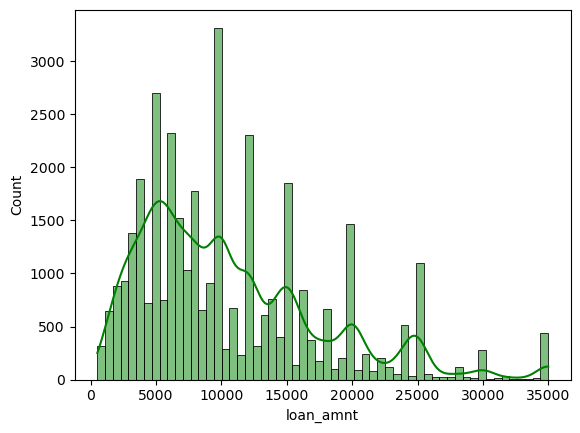

In [49]:
sns.histplot(df_with_fully_paid_and_charged_off_loan_status, x=df_with_fully_paid_and_charged_off_loan_status['loan_amnt'], kde=True, color='g')
mplt.show()

#### UA Analysis 3: 36 months term is more common for applying the loan

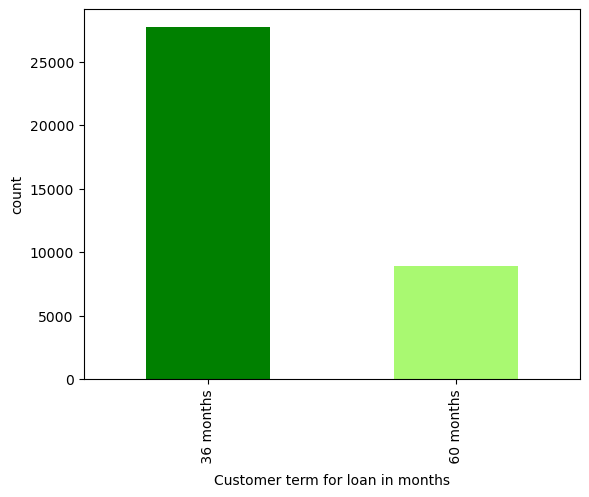

In [51]:
ax = df_with_fully_paid_and_charged_off_loan_status['term'].value_counts().plot.bar(color=['g', '#a9f971'])
ax.set_xlabel('Customer term for loan in months')
ax.set_ylabel('count')
mplt.show()

#### UA Analysis 4: Most of the grades provided by LC are B & A

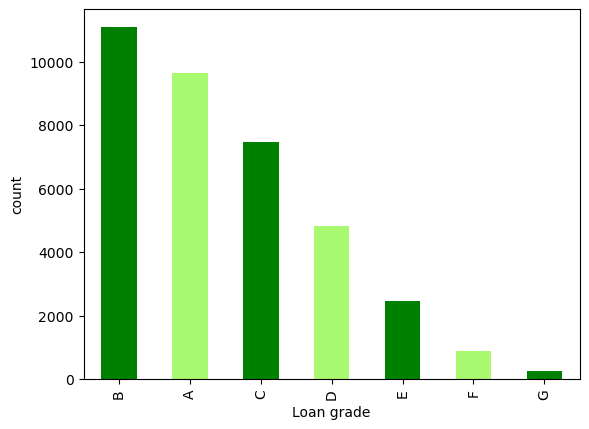

In [53]:
ax = df_with_fully_paid_and_charged_off_loan_status['grade'].value_counts().plot.bar(color=['g', '#a9f971'])
ax.set_xlabel('Loan grade')
ax.set_ylabel('count')
mplt.show()

#### UA Analysis 5: Most of the home ownership is in Rent & Mortgage, and very few customers own the property

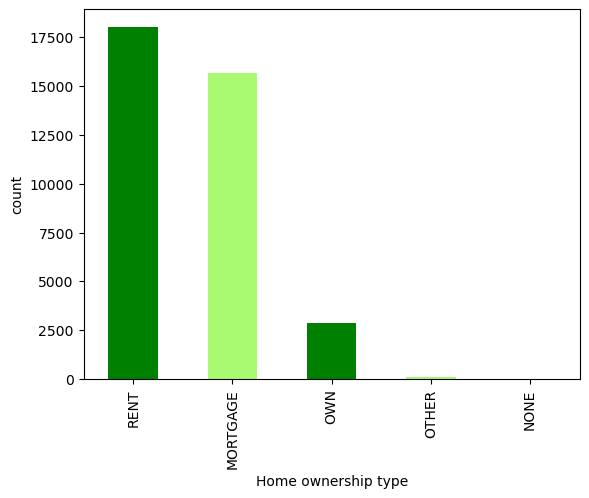

In [55]:
ax = df_with_fully_paid_and_charged_off_loan_status['home_ownership'].value_counts().plot.bar(color=['g', '#a9f971'])
ax.set_xlabel('Home ownership type')
ax.set_ylabel('count')
mplt.show()
mplt.show()

#### UA Analysis 6: Most of the loan is taken for dedt consolidation & credir card

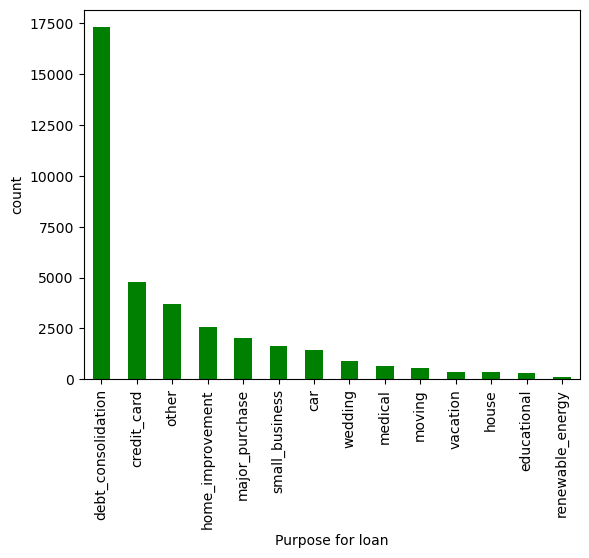

In [57]:
ax = df_with_fully_paid_and_charged_off_loan_status['purpose'].value_counts().plot.bar(color='g')
ax.set_xlabel('Purpose for loan')
ax.set_ylabel('count')
mplt.show()
mplt.show()

#### UA Analysis 7: Top 3 states where most of the loan is taken are CA, NY & FL

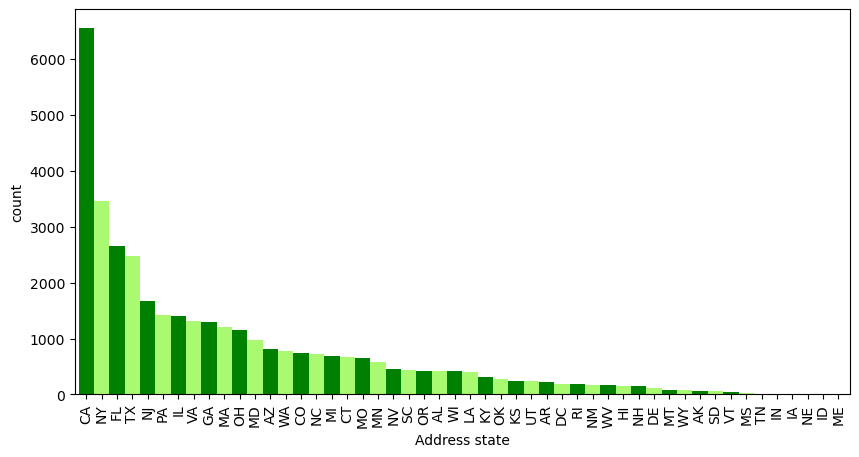

In [59]:
mplt.figure(figsize=(10,5))
ax = df_with_fully_paid_and_charged_off_loan_status['addr_state'].value_counts().plot.bar(color=['g', '#a9f971'],  width=1)
ax.set_xlabel('Address state')
ax.set_ylabel('count')
mplt.show()
mplt.show()

#### UA Analysis 8: DTI density is mostly around 10 - 15 range

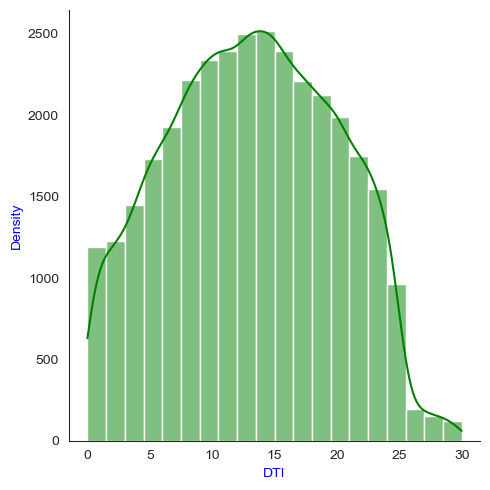

In [61]:
sns.set_style('white')
sns.displot(df_with_fully_paid_loan_status['dti'], bins=20, kde=True,color='g')
mplt.xlabel('DTI', fontdict={'fontweight': '20', 'color': 'b'})
mplt.ylabel('Density', fontdict={'fontweight': '20', 'color': 'b'})
mplt.show()

#### UA Analysis 9: Most customers have no delinquencies 

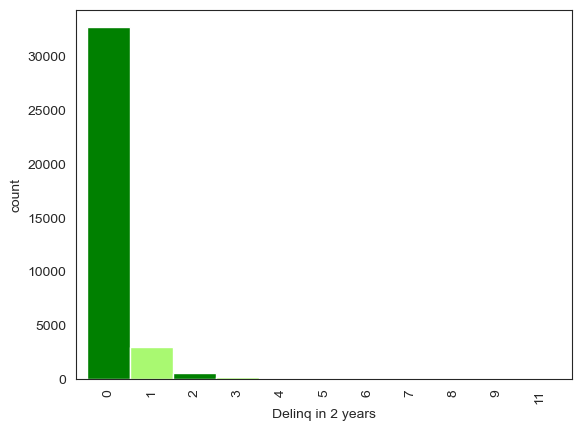

In [63]:
ax = df_with_fully_paid_and_charged_off_loan_status['delinq_2yrs'].value_counts().plot.bar(color=['g', '#a9f971'],  width=1)
ax.set_xlabel('Delinq in 2 years')
ax.set_ylabel('count')
mplt.show()
mplt.show()

#### UA Analysis 10: Most customers had no Inquiries; however 1 inquiry is high

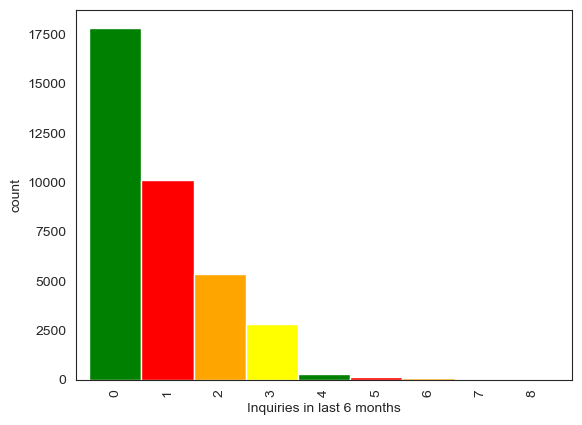

In [65]:
ax = df_with_fully_paid_and_charged_off_loan_status['inq_last_6mths'].value_counts().plot.bar(color=['g', 'red', 'orange', 'yellow'],  width=1)
ax.set_xlabel('Inquiries in last 6 months')
ax.set_ylabel('count')
mplt.show()
mplt.show()

#### UA Analysis 11: Number of derogatory public records are low; however there are some public records

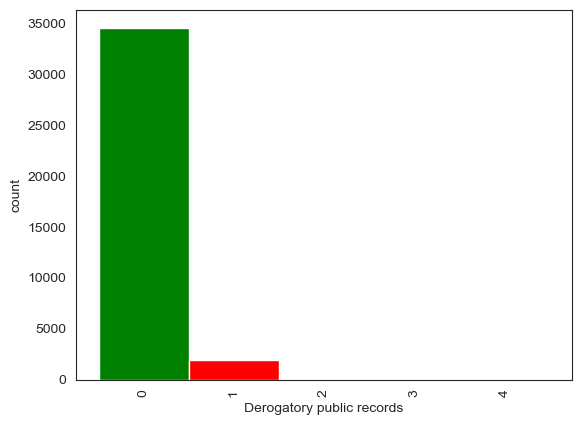

In [67]:
ax = df_with_fully_paid_and_charged_off_loan_status['pub_rec'].value_counts().plot.bar(color=['g', 'red'],  width=1)
ax.set_xlabel('Derogatory public records')
ax.set_ylabel('count')
mplt.show()
mplt.show()

#### UA Analysis 12: Most of the customers are utilizing/consuming higher ratio of the borrowed amount of credit

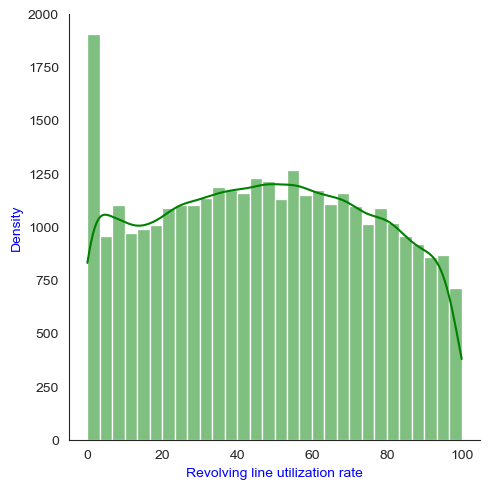

In [69]:
sns.set_style('white')
sns.displot(df_with_fully_paid_loan_status['revol_util'], bins=30, kde=True,color='g')
mplt.xlabel('Revolving line utilization rate', fontdict={'fontweight': '20', 'color': 'b'})
mplt.ylabel('Density', fontdict={'fontweight': '20', 'color': 'b'})
mplt.show()

#### UA Analysis 13: Most of the customers who are taking loans are not earning high

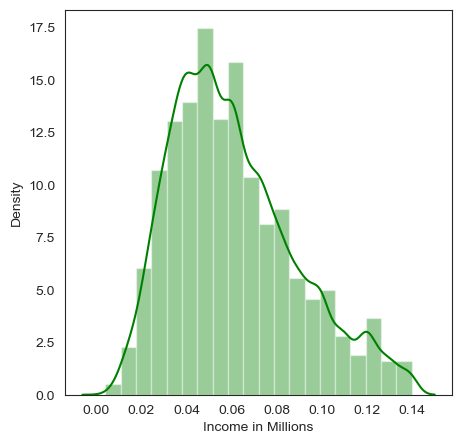

In [71]:
sns.set_style('white')
mplt.figure(figsize=(5,5))
sns.distplot(df_with_fully_paid_and_charged_off_loan_status.annual_inc/1000000, bins=20 , kde=True, color='g')
mplt.xlabel('Income in Millions')
mplt.ylabel('Density')
mplt.show()

#### UA Analysis 14: Customers are having many credit lines for loans, higher density around 10 - 30

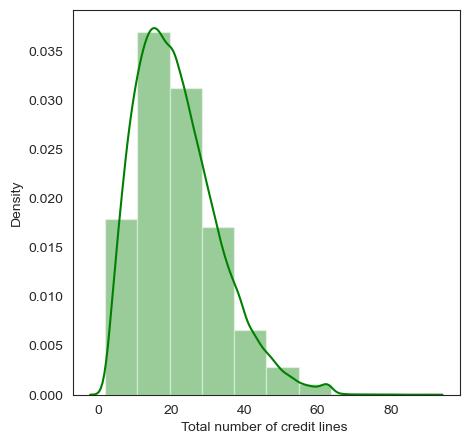

In [73]:
sns.set_style('white')
mplt.figure(figsize=(5,5))
sns.distplot(df_with_fully_paid_and_charged_off_loan_status.total_acc, bins=10 , kde=True, color='g')
mplt.xlabel('Total number of credit lines ')
mplt.ylabel('Density')
mplt.show()

#### UA Analysis 15: Customers are not having many public record bankruptcies

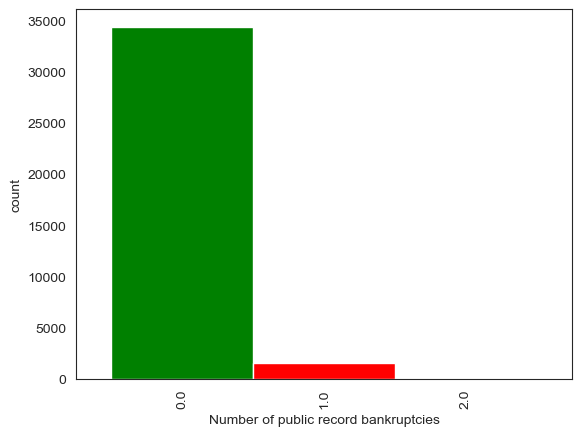

In [75]:
ax = df_with_fully_paid_and_charged_off_loan_status['pub_rec_bankruptcies'].value_counts().plot.bar(color=['g', 'red'],  width=1)
ax.set_xlabel('Number of public record bankruptcies')
ax.set_ylabel('count')
mplt.show()
mplt.show()

#### UA Analysis 16: Concentration of the annual income is around 48k; Median of the income is 59k

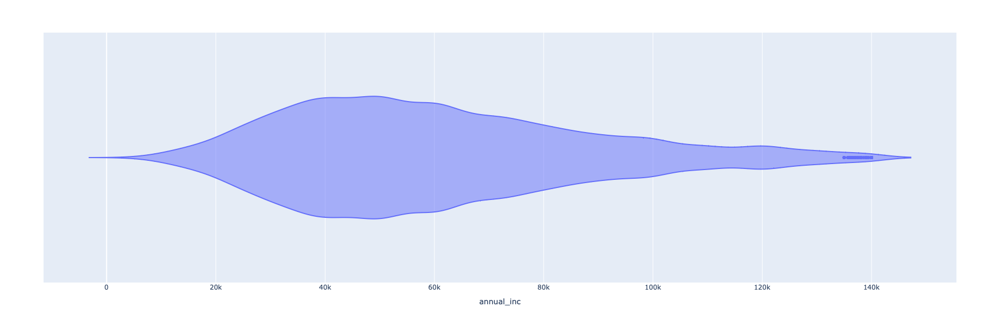

In [77]:
fig = px.violin(df_with_fully_paid_and_charged_off_loan_status, x="annual_inc", width=1000, height=600)
fig.show()

**Observation(s) from the Univariate analysis:**

1. Most of the loans are applied by the customers within the 10+ years range
2. Most of the loan amount is within 5000 - 10000 range
3. 36 months term is more common for applying the loan
4. Most of the grades provided by LC are B & A
5. Most of the home ownership is in Rent & Mortgage, and very few customers own the property
6. Most of the loan is taken for dedt consolidation & credir card
7. Top 3 states where most of the loan is taken are CA, NY & FL
8. DTI density is mostly around 10 - 15 range
9. Most customers have no delinquencies
10. Most customers had no Inquiries; however 1 inquiry is high
11. Number of derogatory public records are low; however there are some public records
12. Most of the customers are utilizing/consuming higher ratio of the borrowed amount of credit
13. Most of the customers who are taking loans are not earning high
14. Customers are having many credit lines for loans, higher density around 10 - 30
15. Customers are not having many public record bankruptcies
16. Concentration of the annual income is around 48k; Median of the income is 59k

# Segemented Univariate Analysis

In [80]:
# Drop the rows with Current loan status, as they are of no use for predicting the defaulters
df_with_fully_paid_loan_status = df_with_fully_paid_and_charged_off_loan_status[(df_with_fully_paid_and_charged_off_loan_status['loan_status'] == "Fully Paid")]
df_with_charged_off_loan_status = df_with_fully_paid_and_charged_off_loan_status[(df_with_fully_paid_and_charged_off_loan_status['loan_status'] == "Charged Off")]

#### SUA Analysis 1: It's clearly visible that Customers with 36 months term are slightly more prone to default

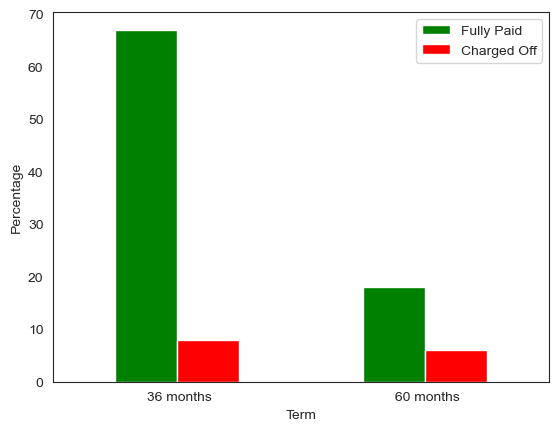

In [82]:
df3 = pd.DataFrame({'Fully Paid': round(df_with_fully_paid_loan_status['term'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100 ,
                   'Charged Off': round(df_with_charged_off_loan_status['term'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100})


ax = df3.plot.bar(color=['g', 'red'], rot=0)
ax.set_xlabel('Term')
ax.set_ylabel('Percentage')
mplt.show()

#### SUA Analysis 2: It's clearly visible that Customers with 10+ years & less than 1 year default less and will pay the loan; however among defaulters this bracket is also high

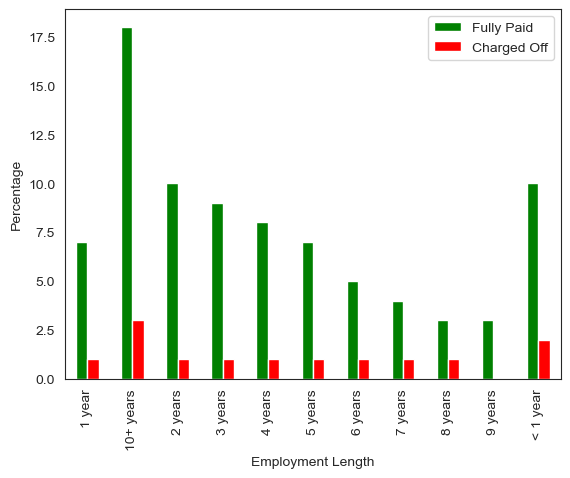

In [84]:
df3 = pd.DataFrame({'Fully Paid': round(df_with_fully_paid_loan_status['emp_length'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100,
                   'Charged Off': round(df_with_charged_off_loan_status['emp_length'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100})


ax = df3.plot.bar(color=['g', 'red'])
ax.set_xlabel('Employment Length')
ax.set_ylabel('Percentage')
mplt.show()

#### SUA Analysis 3: It's clearly visible that Customers with Grade A, E or F default less; however Customers with Grade B or C default more

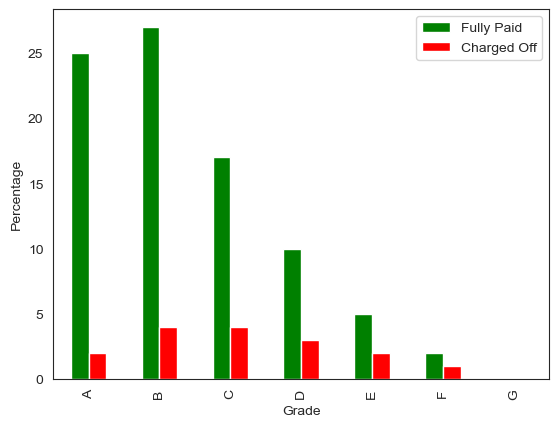

In [86]:
df3 = pd.DataFrame({'Fully Paid': round(df_with_fully_paid_loan_status['grade'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100,
                   'Charged Off': round(df_with_charged_off_loan_status['grade'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100})


ax = df3.plot.bar(color=['g', 'red'])
ax.set_xlabel('Grade')
ax.set_ylabel('Percentage')
mplt.show()

#### SUA Analysis 4: It's clearly visible that Customers who own property default less; Customers on Rent are slightly more prone to default

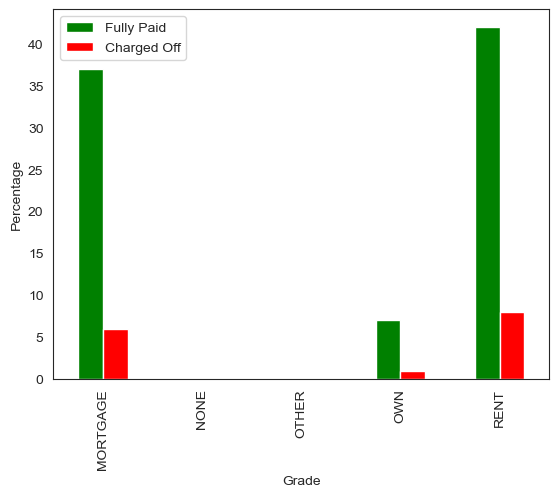

In [88]:
df3 = pd.DataFrame({'Fully Paid': round(df_with_fully_paid_loan_status['home_ownership'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100,
                   'Charged Off': round(df_with_charged_off_loan_status['home_ownership'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100})


ax = df3.plot.bar(color=['g', 'red'])
ax.set_xlabel('Grade')
ax.set_ylabel('Percentage')
mplt.show()


#### SUA Analysis 5: It's clearly visible that Customers who took loan for dedt consolidiation are more prone to default as well as they can repay the full loan

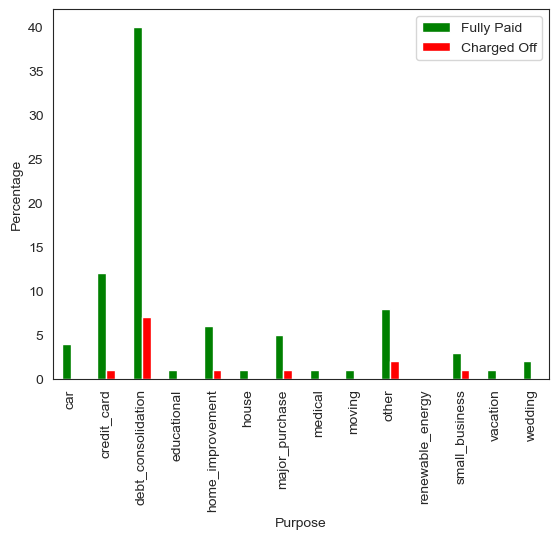

In [90]:
df3 = pd.DataFrame({'Fully Paid': round(df_with_fully_paid_loan_status['purpose'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100,
                   'Charged Off': round(df_with_charged_off_loan_status['purpose'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100})


ax = df3.plot.bar(color=['g', 'red'])
ax.set_xlabel('Purpose')
ax.set_ylabel('Percentage')
mplt.show()

#### SUA Analysis 6: It's clearly visible that Customers who took loan in CA are more prone to default as well as they can repay the full loan

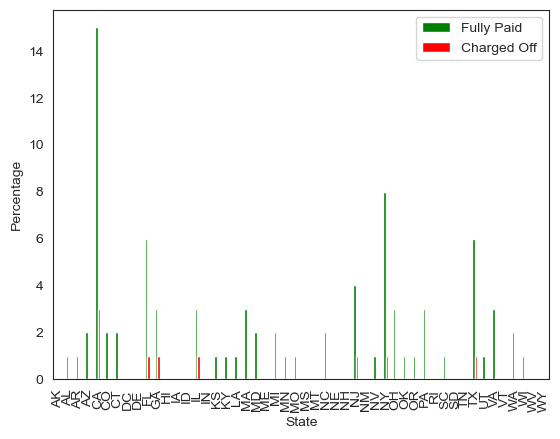

In [92]:
df3 = pd.DataFrame({'Fully Paid': round(df_with_fully_paid_loan_status['addr_state'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100,
                   'Charged Off': round(df_with_charged_off_loan_status['addr_state'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100})


ax = df3.plot.bar(color=['g', 'red'])
ax.set_xlabel('State')
ax.set_ylabel('Percentage')
mplt.show()

#### SUA Analysis 7: It's clearly visible that Customers who took loan mostly in 2011 defaulted more

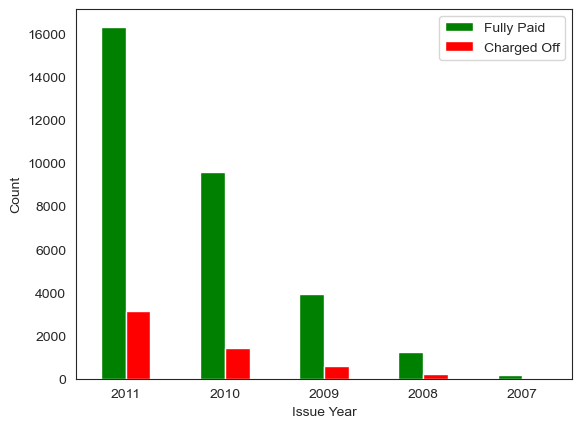

In [94]:
df3 = pd.DataFrame({'Fully Paid': df_with_fully_paid_loan_status['issue_yr'].value_counts(),
                   'Charged Off': df_with_charged_off_loan_status['issue_yr'].value_counts()})


ax = df3.plot.bar(color=['g', 'red'], rot=0)
ax.set_xlabel('Issue Year')
ax.set_ylabel('Count')
mplt.show()

#### SUA Analysis 8: It's clearly visible that Customers who defaulted have higher percentile of DTI with 19.41 & Even the lower percentile of the Charged off is higher than Fully paid customers

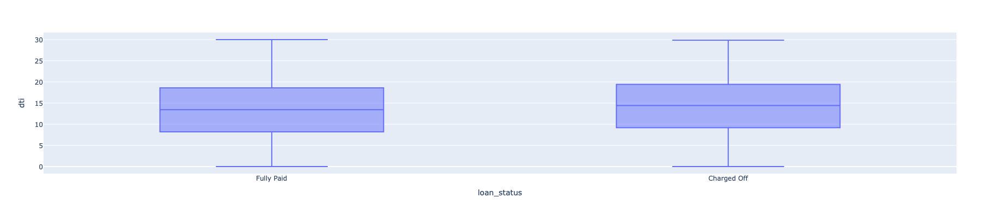

In [96]:
fig = px.box(df_with_fully_paid_and_charged_off_loan_status, x="loan_status", y="dti", width=500, height=400)
fig.show()

#### SUA Analysis 9: Looks like customers with 1 inquiries in last 6 months are more likely to default

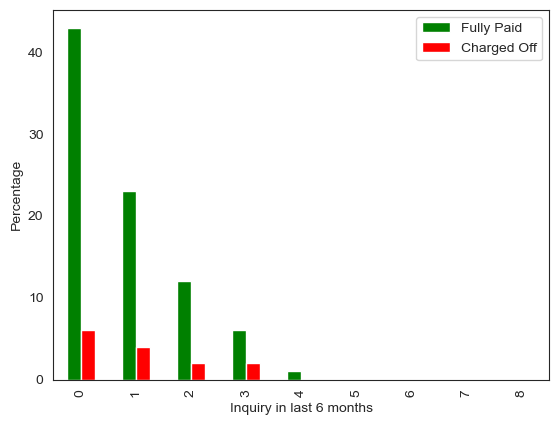

In [98]:


df3 = pd.DataFrame({'Fully Paid': round(df_with_fully_paid_loan_status['inq_last_6mths'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100,
                   'Charged Off': round(df_with_charged_off_loan_status['inq_last_6mths'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100})


ax = df3.plot.bar(color=['g', 'red'])
ax.set_xlabel('Inquiry in last 6 months')
ax.set_ylabel('Percentage')
mplt.show()

#### SUA Analysis 10: Customers with Public record bankruptcies slightly prone to defaults

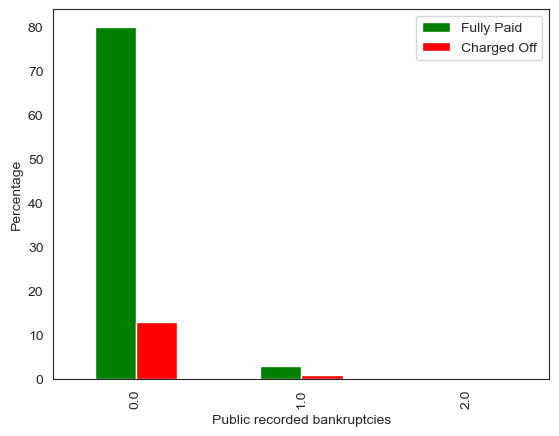

In [100]:
df3 = pd.DataFrame({'Fully Paid': round(df_with_fully_paid_loan_status['pub_rec_bankruptcies'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100,
                   'Charged Off': round(df_with_charged_off_loan_status['pub_rec_bankruptcies'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100})


ax = df3.plot.bar(color=['g', 'red'])
ax.set_xlabel('Public recorded bankruptcies')
ax.set_ylabel('Percentage')
mplt.show()

#### SUA Analysis 11: Income distribution (25 - 75 percentile) for Charged off is 36 - 72 ; Income distribution (25 - 75 percentile) for Fully Paid is 40 - 79. This means customers income between 36 and 40 has higher chance of default

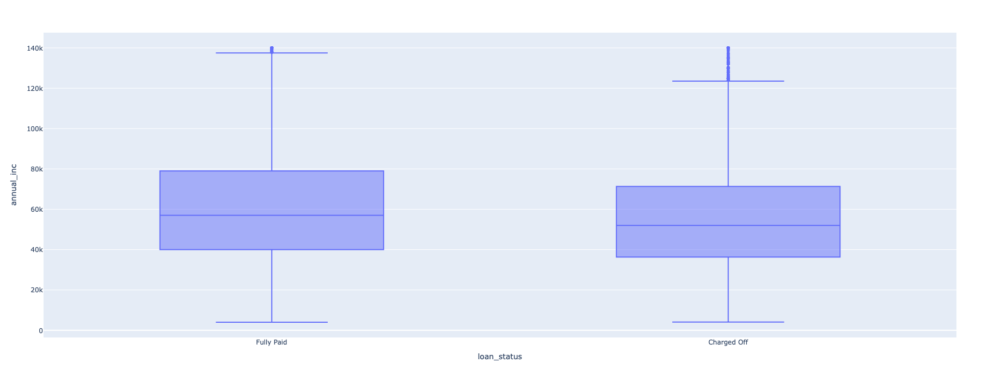

In [102]:
fig = px.box(df_with_fully_paid_and_charged_off_loan_status, x="loan_status", y="annual_inc", width=700, height=700)
fig.show()

#### SUA Analysis 12: Total principal received less than 5000 indicate more likelihood of charged_off customers

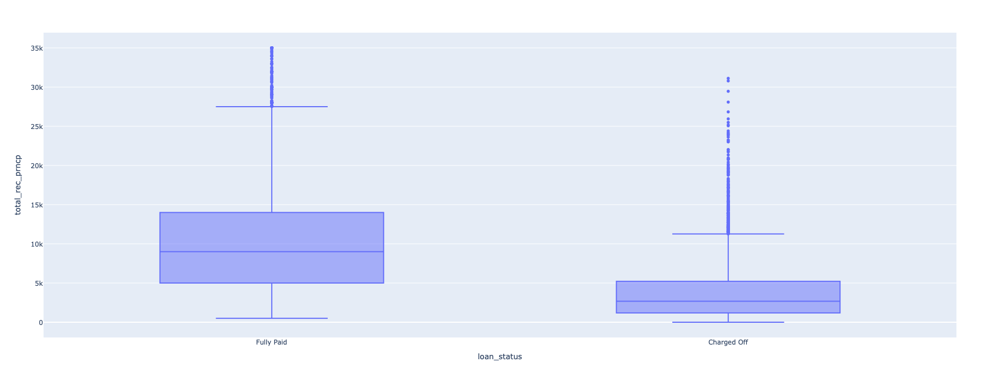

In [104]:
fig = px.box(df_with_fully_paid_and_charged_off_loan_status, x="loan_status", y="total_rec_prncp", width=700, height=700)
fig.show()

#### SUA Analysis 13: Larger amount of loan contributes to higher probability to default 

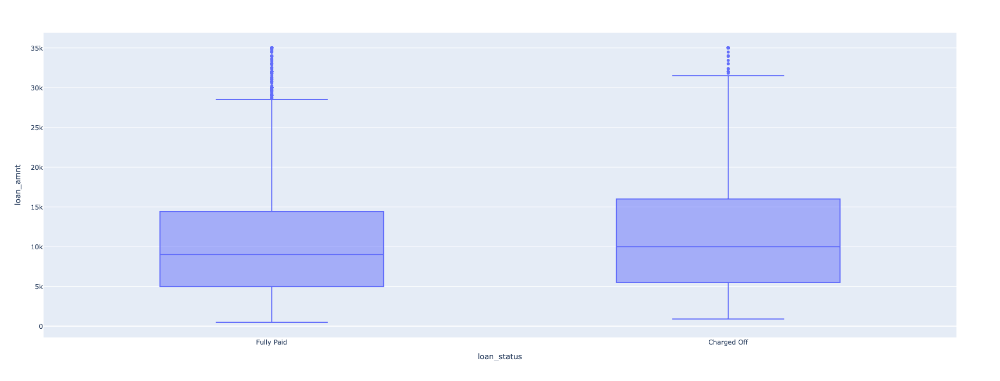

In [106]:
fig = px.box(df_with_fully_paid_and_charged_off_loan_status, x="loan_status", y="loan_amnt", width=700, height=700)
fig.show()

#### SUA Analysis 14: 
1. Count of loans taken increases from January towards December almost linearly
2. Defaulted loan counts show almost constant pattern across the year

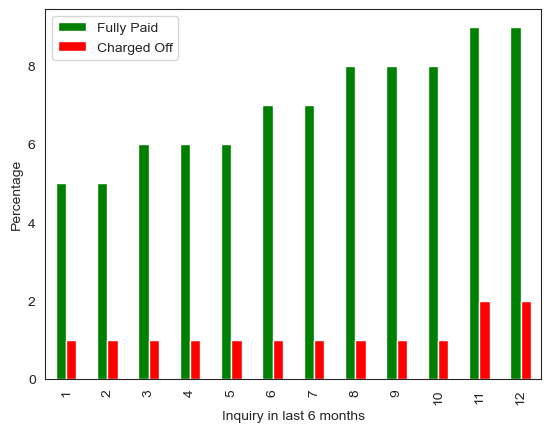

In [108]:
df3 = pd.DataFrame({'Fully Paid': round(df_with_fully_paid_loan_status['issue_mth'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100,
                   'Charged Off': round(df_with_charged_off_loan_status['issue_mth'].value_counts()/df_with_fully_paid_and_charged_off_loan_status.shape[0], 2) * 100})


ax = df3.plot.bar(color=['g', 'red'])
ax.set_xlabel('Inquiry in last 6 months')
ax.set_ylabel('Percentage')
mplt.show()

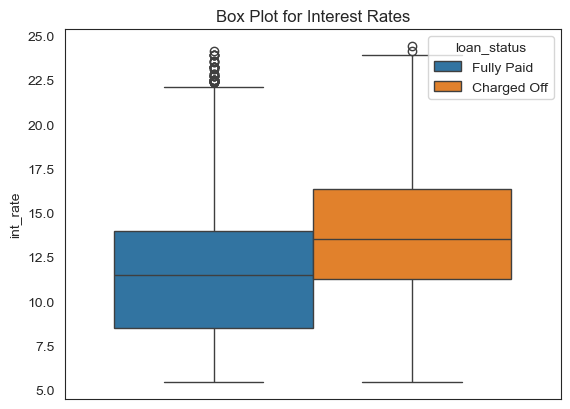

In [109]:
# Interest Rate
sns.boxplot(df_with_fully_paid_and_charged_off_loan_status, y='int_rate', hue='loan_status')
mplt.title(f'Box Plot for Interest Rates')
mplt.show()

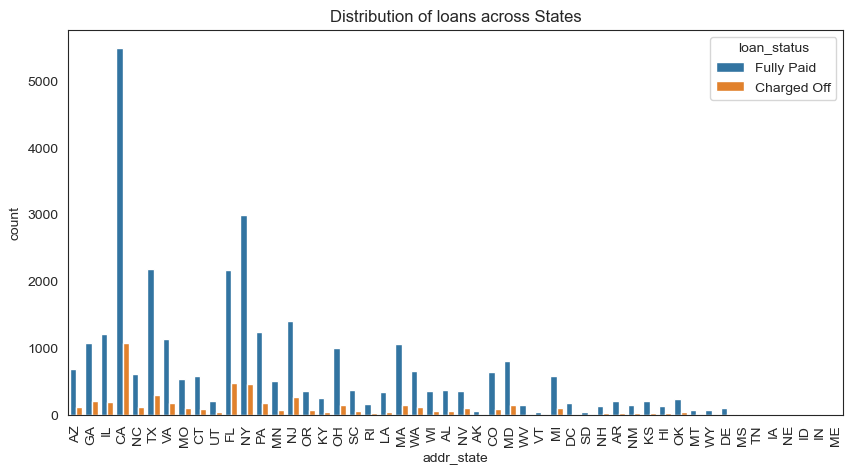

In [110]:
# Statewise Bivariate Count Plot
mplt.figure(figsize=(10,5))
sns.countplot(df_with_fully_paid_and_charged_off_loan_status, x='addr_state', hue='loan_status')
mplt.title(f'Distribution of loans across States')
mplt.xticks(rotation=90)
mplt.show()

**Observation(s) realted to the Segemented Univariate analysis:**

**Weak link:**
1. Customers with Public record bankruptcies slightly prone to defaults
2. Defaulted loan counts show almost constant pattern across the year; More defaults takes place in November & December month

**Strong link:**
1. Customers with 10+ years & less than 1 year have higher probality to default, including chance to pay fully paid the loan
2. Customers with Grade B or C default more
3. Customers who own property default less; however, Customers on Rent are slightly more prone to default
4. Customers who took loan for dedt consolidiation are more prone to default & highest number of fully paid
5. Customers who took loan in CA are more prone to default as well as they can repay the full loan
6. Customers who took loan mostly in 2011 defaulted more
7. Customers who defaulted have higher percentile of DTI with 19.41 & Even the lower percentile of the Charged off is higher than Fully paid customers
8. Customers with 1 inquiries in last 6 months are more likely to default
9. Income distribution (25 - 75 percentile) for Charged off is 36 - 72 ; Income distribution (25 - 75 percentile) for Fully Paid is 40 - 79. This means customers income between 36 and 40 has higher chance of default
10. Total principal received less than 5000 indicate more likelihood of charged_off customers
11. Larger amount of loan contributes to higher chance of defaulting
12. Customers with interest rate more than 13.75% appear to default more likely

# Bivariate Analysis

#### BA Analysis 1: 

**Negative Correlation:**
1. Between dti and annual income
2. Between last payment amount and delinquency within 2 years
3. Between Annual income and public records
4. Between Public recorded bankruptcies & installments
5. Between Total Payment & delinquency within 2 years
6. Between Inquiries in last 6 months & Total Payment
7. Between Public records & loan amount

**Strong Positive Correlation:**
1. Between Total amount & installments
2. Between Total payment & Total interest received
3. Between Total payment & installment

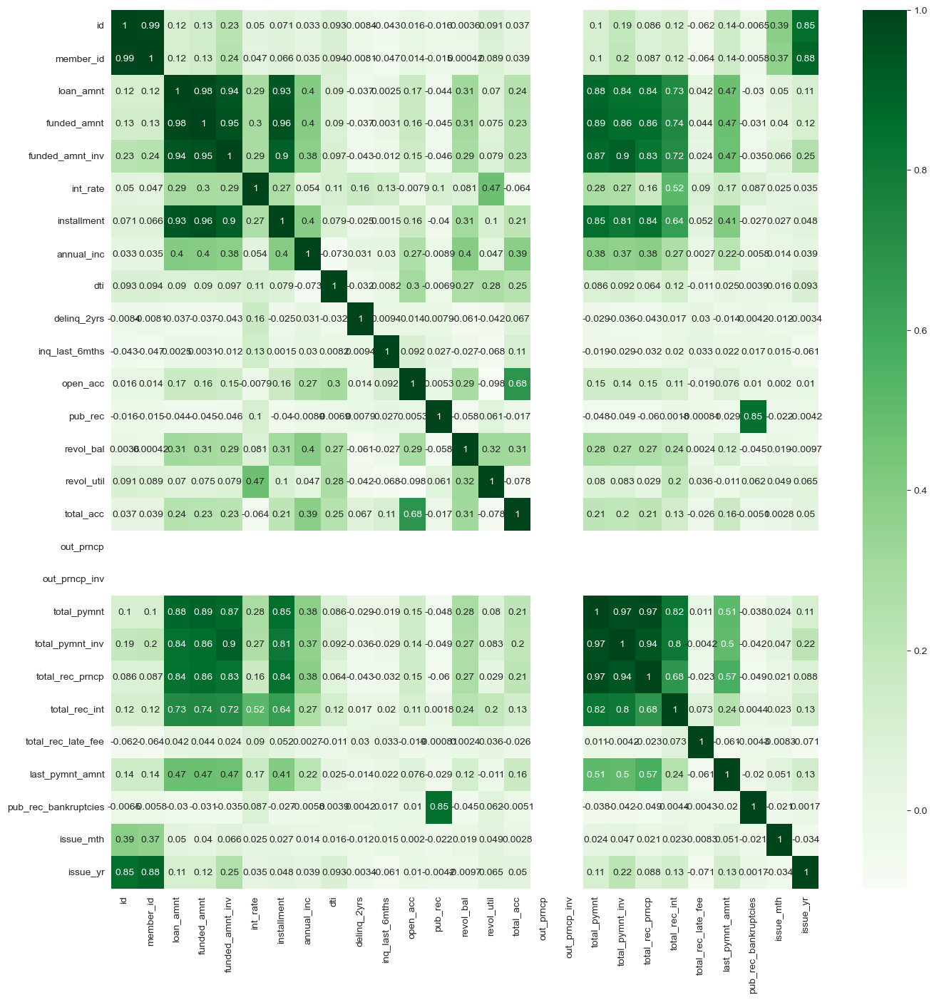

In [114]:
mplt.figure(figsize=(16,16))
num_cols = ['int64', 'float64']
df_num = df_with_fully_paid_and_charged_off_loan_status.select_dtypes(include=num_cols)
correlation_matrix = df_num.corr()
sns.heatmap(correlation_matrix, cmap="Greens", annot=True)
mplt.show()

#### BA Analysis 2: Loan amount distribution for the most used purposes i.e. debt_consolidation & credit_card is almost same

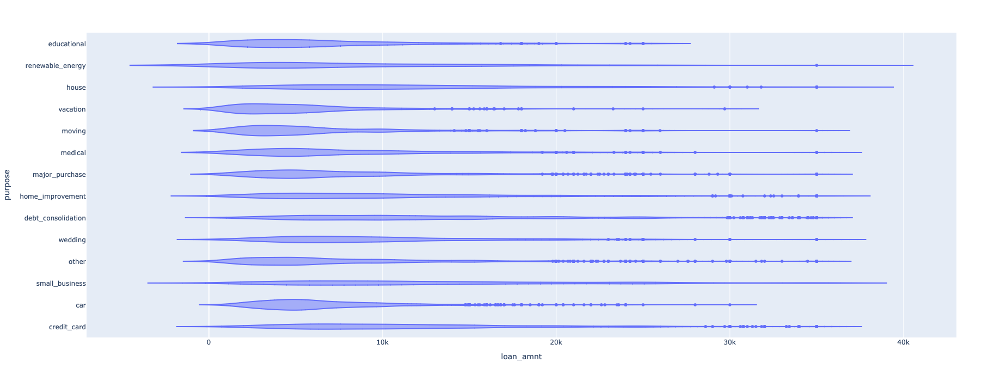

In [116]:
fig = px.violin(df_with_fully_paid_and_charged_off_loan_status, y="purpose", x="loan_amnt", width=700, height=700)
fig.show()

#### BA Analysis 3: Interest rate is increasing with the number of years

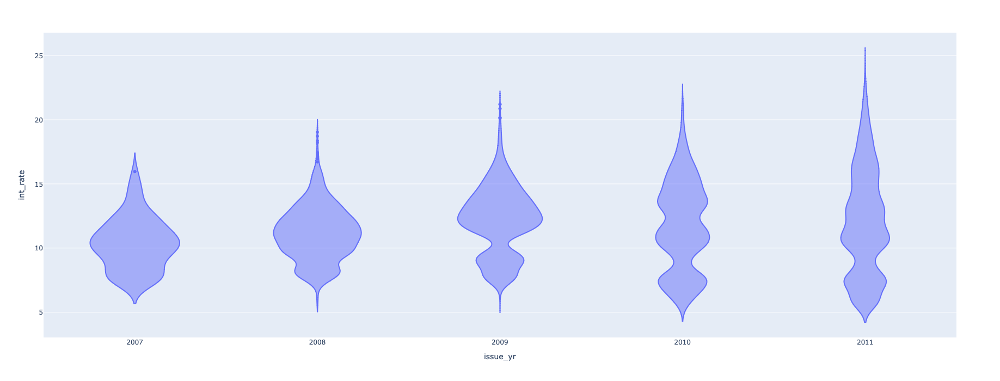

In [118]:
fig = px.violin(df_with_fully_paid_and_charged_off_loan_status, x="issue_yr", y="int_rate", width=700, height=700)
fig.show()

#### BA Analysis 4: Interest rate is increasing with the dti ratio

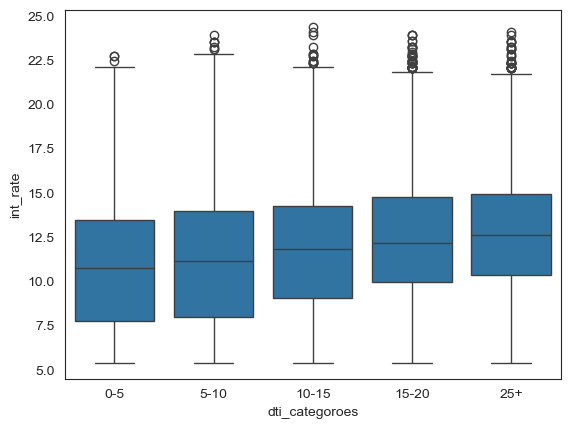

In [120]:
df_with_fully_paid_and_charged_off_loan_status['dti_categoroes'] = pd.cut(df_with_fully_paid_and_charged_off_loan_status['dti'], [0, 5, 10, 15, 20, 25], labels=['0-5', '5-10', '10-15', '15-20', '25+'])
sns.boxplot(df_with_fully_paid_and_charged_off_loan_status, x="dti_categoroes", y="int_rate")
mplt.show()

#### BA Analysis 5: As the income increases dti reduces

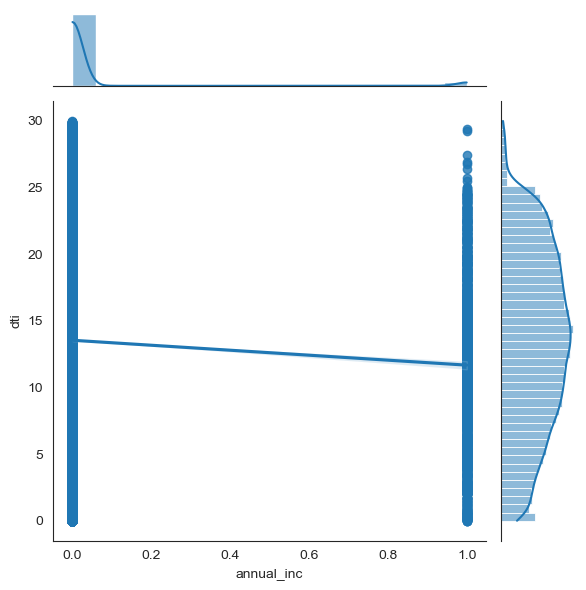

In [122]:
sns.jointplot(x=np.percentile(df_with_fully_paid_and_charged_off_loan_status.annual_inc/1000000, 95) < df_with_fully_paid_and_charged_off_loan_status.annual_inc/1000000, y=df_with_fully_paid_and_charged_off_loan_status.dti , kind='reg')
mplt.show()

#### BA Analysis 6: Interest rate increasing with the loan

<Axes: xlabel='loan_amount_category', ylabel='int_rate'>

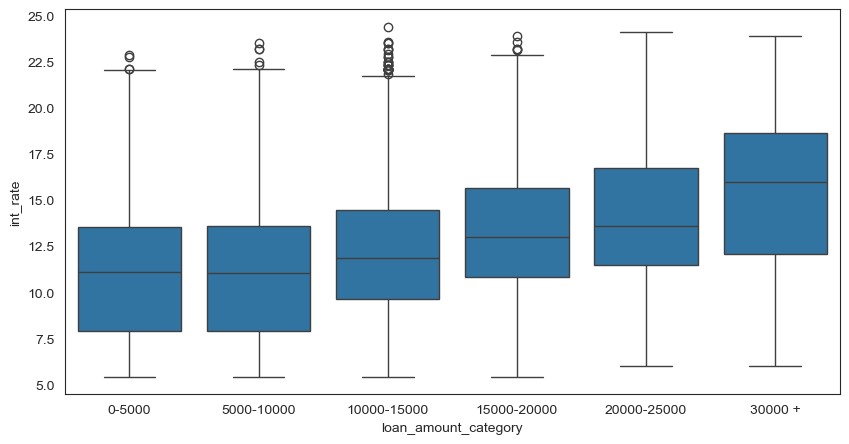

In [124]:
mplt.figure(figsize=(10,5))
df_with_fully_paid_and_charged_off_loan_status['loan_amount_category'] = pd.cut(df_with_fully_paid_and_charged_off_loan_status['loan_amnt'], [0, 5000, 10000, 15000, 20000, 25000, 30000], labels=['0-5000', '5000-10000', '10000-15000', '15000-20000', '20000-25000', '30000 +'])
sns.boxplot(y='int_rate', x='loan_amount_category', data =df_with_fully_paid_and_charged_off_loan_status)

#### BA Analysis 7: DTI is lower for higher grades such as A & B

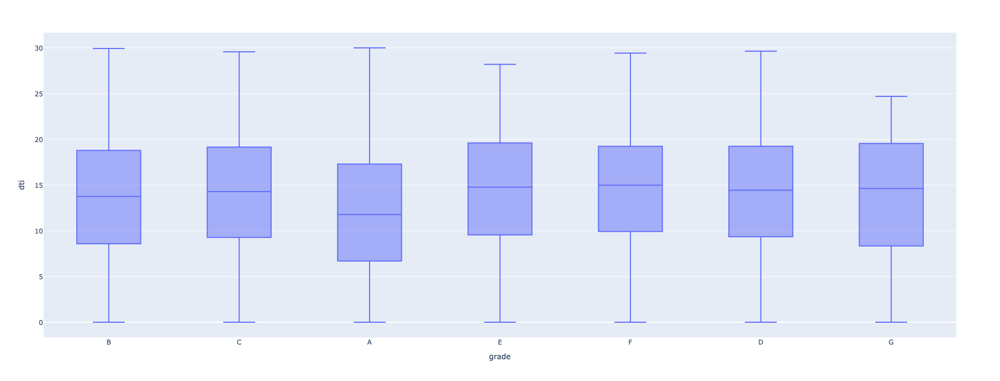

In [126]:
fig = px.box(df_with_fully_paid_and_charged_off_loan_status, x="grade", y="dti", width=700, height=700)
fig.show()

#### BA Analysis 8: DTI is higher for debt_consolidation & credit card

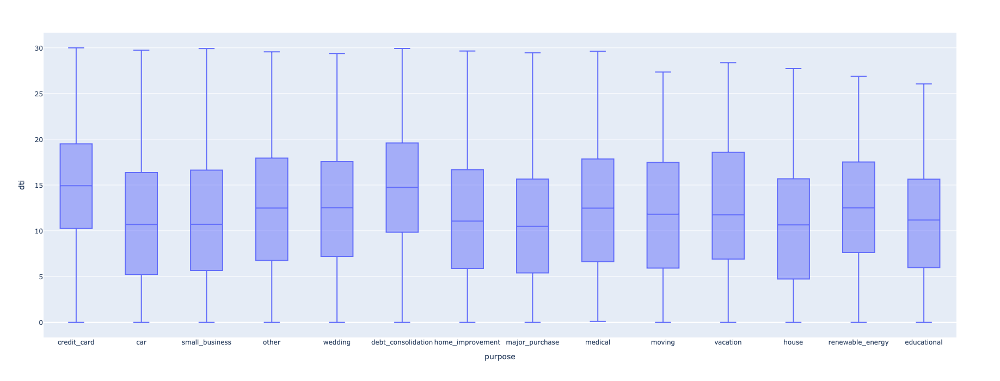

In [128]:
fig = px.box(df_with_fully_paid_and_charged_off_loan_status, x="purpose", y="dti", width=700, height=700)
fig.show()

**Observation(s) realted to the Bivariate analysis:**

1. Interest rate is increasing with the number of years. Therefore sooner the customer takes the loan most probably less would be the interest rate. Based on this we should analyze most recent applications for loan more thoroughly than the customers who are coming for renewals
2. As the income increases dti reduces. Therefore higher income customers would default less and could be good rating clients
3. Interest rate increases with the loan. Therefore higher loan amounts should be evaluated more strongly
4. Loan amount distribution for the most used purposes i.e. debt_consolidation & credit_card is almost same. However, in the debt_consolidation categorgy customers have defaulted more. Therefore, loan distribution for a pupose does not gurantee that the particular group of customers with a specific purpose will default more
5. Interest rate is increasing with the dti ratio. Therefore customers with bad dti will have higher interest rates and that's higher potential to default
6. LC Grade 'A' has the best dti. Therefore, loans given with grades A, B has best DTIs

## **Recommendations:**

1. DTI impacts the repayment of the loans. This we have verified through Grades, interest rates and annual income therefore before approving loans DTI should be verified correctly and thoroughly
2. Most of the analysis confirm that loans which are approved with higher Grades has high probability of repayment therefore this concludes that banker should approve more loans with higher grades
3. Customers who are taking loans for debt consolidation or credit card should be thoroughly verified against other factors such as loan Grades and DTI
4. We have observed that there is negative correlation between Public recorded bankruptcies & Installments therefore customers with more Public recorded bankruptcies should be verified correctly and thoroughly
5. We have observed that there is negative correlation between Public records & loan amounts therefore customers with more Public records should be verified correctly and thoroughly before approving loans

##### **Based on above we can conclude that following are major driving factors behind charged off loans:**

1. Grades
2. Interest Rates
3. DTI
4. Annual income
5. Purpose of the loan
6. Public recorded bankruptcies
7. Public records
8. Installments

##### **Other Factors to consider:**

1. Customers with 10+ years & less than 1 year have higher probality to default
2. Customers who own property default less; however, Customers on Rent are slightly more prone to default
3. Customers who took loan in CA are more prone to default as well as they can repay the full loan
4. Customers with 1 inquiries in last 6 months are more likely to default
5. Larger amount of loan contributes to higher chance of defaulting as it increases the interest rate
